### Import Modules

In [1]:
import matplotlib.pyplot as plt
import os, copy, glob
import reproject
from astropy.io import fits
from astropy.wcs import WCS

In [2]:
# Added Modules for Registration
from astropy.io import fits
from utils import ProjectionVisualizer

In [3]:
from config import *
from config_VVV_IRAC import *
from utils import GridVisualizer
from dataset import FitsArrayConverter
from dataset import ImageStacker, ImageAugmentation

### Configuration

In [4]:
if torch.cuda.is_available():
    torch.cuda.set_device(1)
    device = "cuda:1"

In [5]:
print(f'Base Directory: {root_dir}')
print('Device:', device)
print(f"Number of CPU Cores: {num_cores}")

Base Directory: /home/jiwon/UKIDSSxIRAC
Device: cuda:1
Number of CPU Cores: 32


### Data Preparation

#### Settings

In [6]:
# # Make Data Directory
# dirname = f'origianl_gc_images_registration'
# if not os.path.exists(root_dir+'/data_added/'+dirname+'/'+survey1):
#     print(f'\n=== Making "data_added/{dirname}" Directory ===\n')
#     os.makedirs(root_dir+f'/data_added/{dirname}')
#     os.makedirs(root_dir+f'/data_added/{dirname}/'+survey1)
#     os.makedirs(root_dir+f'/data_added/{dirname}/'+survey2)


=== Making "data_added/origianl_gc_images_registration" Directory ===



#### Make a Filelist for Whole Image (Raw)

In [6]:
# List Up the Files
image_dir1 = os.path.join(root_dir,'images_added',survey1+'_raw')
image_dir2 = os.path.join(root_dir,'images_added',survey2+'_raw')

imagelist = []
ref_header_filename = None

imagelist1 = sorted([os.path.abspath(x) for x in glob.glob(os.path.join(image_dir1, f'gc_*.fits.fz'))])
imagelist2 = sorted([os.path.abspath(x) for x in glob.glob(os.path.join(image_dir2, f'gc_*.fits'))])
imagelist= imagelist1+imagelist2
# print('\n'.join(imagelist), '\n')

# Find the Reference Coord File
try:
    from config import ref_coord_band
    ref_header_filename = imagelist[next(i for i, file in enumerate(imagelist) if f'_{ref_coord_band}' in file)]
except StopIteration:
    ref_header_filename = None
    print(f'No reference coordinate file found!')

In [7]:
print('\n'.join(imagelist), '\n')

/home/jiwon/UKIDSSxIRAC/images_added/vvv_raw/gc_vvv_H.fits.fz
/home/jiwon/UKIDSSxIRAC/images_added/vvv_raw/gc_vvv_J.fits.fz
/home/jiwon/UKIDSSxIRAC/images_added/vvv_raw/gc_vvv_K.fits.fz
/home/jiwon/UKIDSSxIRAC/images_added/spitzer_raw/gc_irac_ch1_jun06_eq_withsub.fits
/home/jiwon/UKIDSSxIRAC/images_added/spitzer_raw/gc_irac_ch2_jun06_eq_withsub.fits
/home/jiwon/UKIDSSxIRAC/images_added/spitzer_raw/gc_irac_ch3_jun06_eq_withsub.fits
/home/jiwon/UKIDSSxIRAC/images_added/spitzer_raw/gc_irac_ch4_jun06_eq_withsub.fits 



#### Check the Key Names in the Header

In [9]:
def get_image(filename, header=False):
    file = fits.open(filename)
    image = file[-1].data
    if header:
        header = file[-1].header
        return image, header
    else:
        return image

In [10]:
### VVV
ref_image, ref_header = get_image(ref_header_filename, header=True)
# ref_header

In [11]:
### IRAC
imagefile = imagelist[3]
org_image, org_header = get_image(imagefile, header=True)
# org_header

In [12]:
update_key_list = ['TELESCOP', 'INSTRUME', 'FILTER', 'BUNIT', 'DATE-OBS', 'CRVAL1', 'CRVAL2', 'CRPIX1', 'CRPIX2']

print('#-- [ VVV ]')
for key in update_key_list:
    print(f"{key}: {ref_header.get(key, 'Not Found ---###')}")

print('\n\n#-- [ IRAC ]')
for key in update_key_list:
    print(f"{key}: {org_header.get(key, 'Not Found ---###')}")

# 'DATE-OBS' == 'DATE_OBS'
# 'FILTER' == 'CHNLNUM'

#-- [ VVV ]
TELESCOP: ESO-VISTA
INSTRUME: VIRCAM
FILTER: Ks
BUNIT: ADU
DATE-OBS: 2015-09-19T00:49:40.1637
CRVAL1: 265.965101155673
CRVAL2: -29.2928579002151
CRPIX1: 6384.017
CRPIX2: 7825.957


#-- [ IRAC ]
TELESCOP: Spitzer
INSTRUME: IRAC
FILTER: Not Found ---###
BUNIT: MJy/sr
DATE-OBS: Not Found ---###
CRVAL1: 266.424809
CRVAL2: -28.936545
CRPIX1: 4343.111691
CRPIX2: 4982.341447


#### Conduct Image Registration

In [22]:
class FitsRegistrationManager:
    def __init__(self):
        pass
    
    def select_frame(self, fits_filename, verbose=None):
        if verbose is None:
            from config import verbose_fits_info as default_verbose_fits_info
            verbose = default_verbose_fits_info
        file = fits.open(fits_filename)
        if verbose:
            file.info()
        if len(file) > 2:
            file.info()
            imagenum = input("Insert the frame number on the FITS info and press the [Enter] button.")
            if imagenum > len(file)-1:
                raise ValueError(f"Frame number should be smaller than {len(file)-1}!")
        else:
            imagenum = -1
        return file, imagenum

    def resize_with_projection(self, filename, ref_header_filename, verbose=False):
        '''
        Parameters:
        - reprojected_image: 2D numpy array of the reprojected image.
        - org_data_header: FITS header from the original image being reprojected (IRAC header).
        - ref_header: FITS header from the reference image (VVV header).
        '''
        if verbose:
            print("Conducting reprojection...")
            print(f"  - Registration target: {os.path.basename(filename)}")
            print(f"  - Reference header: {os.path.basename(ref_header_filename)}")
            
        ref_file, ref_num = self.select_frame(ref_header_filename)
        data_file, data_num = self.select_frame(filename)
        ref_header, org_data_header = ref_file[ref_num].header, data_file[data_num].header
        reprojected_image, _ = reproject.reproject_interp(data_file[data_num], ref_header)
        return reprojected_image, org_data_header, ref_header
    
    def update_header(self, reprojected_image, org_data_header, ref_header, 
                      additional_keys=None, verbose=False):
        if verbose:
            print("Updating header...")

        # Update information based on a copy of original header
        new_header = copy.deepcopy(org_data_header)

        # Update WCS keys from ref_header
        update_keys = [
                'CTYPE1', 'CTYPE2', 'CRVAL1', 'CRVAL2',  # WCS-related keys
                'CRPIX1', 'CRPIX2', 'CD1_1', 'CD1_2', 'CD2_1', 'CD2_2'  # Projection matrix
            ]
        for key in update_keys:
            if key in ref_header:
                new_header[key] = ref_header[key]
            else:
                print(f"  - Key {key} not found in ref_header. Skipping.")
        
        # Update the image dimensions
        new_header['NAXIS'] = 2
        new_header['NAXIS1'] = reprojected_image.shape[1]  # Width of the image
        new_header['NAXIS2'] = reprojected_image.shape[0]  # Height of the image

        # Update EQUINOX and RADESYS if necessary
        if 'EQUINOX' in ref_header:
            new_header['EQUINOX'] = ref_header['EQUINOX']  # Ensure the coordinate system is consistent
        else:
            print("  - EQUINOX key missing in ref_header.")
        if 'RADESYS' in ref_header:
            new_header['RADESYS'] = ref_header['RADESYS']  # Match the reference coordinate system
        else:
            print("  - RADESYS key missing in ref_header.")

        # Dynamically add specific keys from the original header if they exist
        if additional_keys is None:
            additional_keys = ['EXPTIME', 'DATE-OBS', 'DATE_OBS']
        for key in additional_keys:
            if key in org_data_header:
                new_header[key] = org_data_header[key]
                        
        # Preserve specific keys from the original header that are critical
        preserve_keys = ['TELESCOP', 'INSTRUME', 'BUNIT']  # Instrument-related metadata
        for key in preserve_keys:
            if key in org_data_header:
                new_header[key] = org_data_header[key]
            else:
                if verbose:
                    print(f"  - Key {key} not found in org_data_header.")
        if 'FILTER' in org_data_header:
            new_header['FILTER'] = org_data_header['FILTER']
        elif 'CHNLNUM' in org_data_header:
            new_header['FILTER'] = 'CH'+str(org_data_header['CHNLNUM'])
        else:
            if verbose:
                print("  - FILTER and CHNLNUM keys missing in org_data_header.")
        
        # Add comments and history
        new_header['COMMENT'] = "Reprojected to match the VVV coordinate system."
        new_header['HISTORY'] = "Reprojection performed using astropy.reproject."
        return new_header
    
    def save_as_npy(self, reprojected_image, save_name):#, filename, ref_header_filename):
        np.save(save_name, reprojected_image)

    def save_as_fits(self, reprojected_image, new_header, save_name):
        hdu = fits.PrimaryHDU(data=reprojected_image, header=new_header)
        hdu_list = fits.HDUList([hdu])
        hdu_list.writeto(save_name, overwrite=True)

    def get_image(self, filename, header=False):
        file = fits.open(filename)
        image = file[-1].data
        if header:
            header = file[-1].header
            return image, header
        else:
            return image
        
    def get_vmin_vmax(self, image, lower_percentile=1, upper_percentile=99):
        vmin = np.nanpercentile(image, lower_percentile)
        vmax = np.nanpercentile(image, upper_percentile)
        return vmin, vmax
 
    def visualize_result(self, filename, ref_header_filename, image_save=None, verbose=False):
        if verbose: print("Visualizing reprojection result...")
        ref_image, ref_header = self.get_image(ref_header_filename, header=True)
        reprojected_image = self.resize_with_projection(filename, ref_header_filename)[0]
        fig = plt.figure(figsize = (22, 10))

        ax1 = plt.subplot(121, projection=WCS(ref_header))
        min_val, max_val = self.get_vmin_vmax(ref_image, lower_percentile=2, upper_percentile=98)
        ax1.imshow(ref_image, cmap='cividis', origin='lower', vmax=max_val, vmin=min_val)
        ax1.set_xlabel(r'RA')
        ax1.set_ylabel(r'Dec')
        ax1.grid(color='white', ls='dotted')
        _, title = os.path.basename(ref_header_filename.split('.')[0]).split('gc_')
        title = title.split('_')[0:2]
        ax1.set_title(f'Ref Coord: {title[0].upper()}_{title[1]}')

        ax2 =  plt.subplot(122, projection=WCS(ref_header))
        min_val, max_val = self.get_vmin_vmax(reprojected_image, lower_percentile=2, upper_percentile=98)
        ax2.imshow(reprojected_image, cmap='cividis', origin='lower', vmax=max_val, vmin=min_val)
        ax2.set_xlabel(r'RA')
        ax2.set_ylabel(r'Dec')
        ax2.grid(color='white', ls='dotted')
        _, title = os.path.basename(filename.split('.')[0]).split('gc_')
        title = title.split('_')[0:2]
        ax2.set_title(f'Reprojected: {title[0].upper()}_{title[1]}')

        if image_save:
            plt.savefig(image_save, dpi=300, bbox_inches='tight')
            if verbose: print(f"Visualization saved to: \n{image_save}")
        else:
            plt.show()

    def conduct_registration(self, filename, ref_header_filename, save_name, save_as_fits=True, save_as_npy=False, verbose=False):
        '''
        Conducts the full registration process: load, reproject, update header, and save.
    
        Parameters:
        - filename: str, path to the image file to be reprojected.
        - ref_header_filename: str, path to the reference header file.
        - save_name: str, output file name for saving the reprojected image.
        - save_as_fits: bool, whether to save the result as a FITS file (default: True).
        - save_as_npy: bool, whether to save the result as a NumPy file (default: False).
        - verbose: bool, whether to print detailed logs.
        '''
        import time
        start = time.time()

        # Step 1: Reproject the image
        reprojected_image, org_data_header, ref_header = self.resize_with_projection(filename, ref_header_filename, verbose=verbose)
        if verbose:
            print(f"  - Save as FITS: {save_as_fits}, Save as NumPy: {save_as_npy}")
            print(f'Reprojected Image Size: {reprojected_image.shape}')
            print("\n#-- 1. Reprojection completed.\n")

        # Step 2: Update the header
        new_header = self.update_header(reprojected_image, org_data_header, ref_header, verbose=verbose)
        if verbose:
            print("\n#-- 2. Header updated.\n")

        # Step 3: Save the reprojected image
        if save_as_fits:
            fits_save_name = f"{save_name}.fits"
            self.save_as_fits(reprojected_image, new_header, fits_save_name)
            if verbose:
                print(f"\n#-- 3. FITS file saved: {fits_save_name}\n")
        if save_as_npy:
            npy_save_name = f"{save_name}.npy"
            self.save_as_npy(reprojected_image, npy_save_name)
            if verbose:
                print(f"\n#-- 3. NumPy file saved: {npy_save_name}\n")

        if verbose:
            end = time.time()
            print(f"### Registration process completed. [{int(end-start)} sec]")
            print('\n')

#### Conduct Registration (Already Completed)

In [ ]:
fits_registration = FitsRegistrationManager()

image_save_dir = os.path.join(root_dir, 'images_added', 'visualize')
if not os.path.exists(image_save_dir):
    os.makedirs(image_save_dir)
for imagefile in imagelist:
    fits_save_dir = os.path.dirname(imagefile)[0:-4]+'_aligned'
    if not os.path.exists(fits_save_dir):
        os.makedirs(fits_save_dir)
    fits_save_name = '_'.join(os.path.basename(imagefile).split('.fits')[0].split('_')[0:3])
    save_name = fits_save_dir + '/' + fits_save_name

    # fits_registration.conduct_registration(imagefile, ref_header_filename, save_name, save_as_fits=True, verbose=True)
    # fits_registration.visualize_result(imagefile, ref_header_filename, verbose=True,
    #                                    image_save=os.path.join(image_save_dir,fits_save_name+'.png'))

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


  - Save as FITS: True, Save as NumPy: False
Reprojected Image Size: (15652, 12768)

#-- 1. Reprojection completed.

Updating header...
  - RADESYS key missing in ref_header.

#-- 2. Header updated.


#-- 3. FITS file saved: /home/jiwon/UKIDSSxIRAC/images_added/vvv_aligned/gc_vvv_H.fits

### Registration process completed. [833 sec]






  - Save as FITS: True, Save as NumPy: False
Reprojected Image Size: (15652, 12768)

#-- 1. Reprojection completed.

Updating header...
  - RADESYS key missing in ref_header.

#-- 2. Header updated.


#-- 3. FITS file saved: /home/jiwon/UKIDSSxIRAC/images_added/vvv_aligned/gc_vvv_J.fits

### Registration process completed. [854 sec]




  - Save as FITS: True, Save as NumPy: False
Reprojected Image Size: (15652, 12768)

#-- 1. Reprojection completed.

Updating header...
  - RADESYS key missing in ref_header.

#-- 2. Header updated.


#-- 3. FITS file saved: /home/jiwon/UKIDSSxIRAC/images_added/vvv_aligned/gc_vvv_K.fits

### Registration process completed. [834 sec]




  - Save as FITS: True, Save as NumPy: False
Reprojected Image Size: (15652, 12768)

#-- 1. Reprojection completed.

Updating header...
  - RADESYS key missing in ref_header.

#-- 2. Header updated.


#-- 3. FITS file saved: /home/jiwon/UKIDSSxIRAC/images_added/spitzer_aligned/gc_irac_ch1.fits

### Registration process c

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


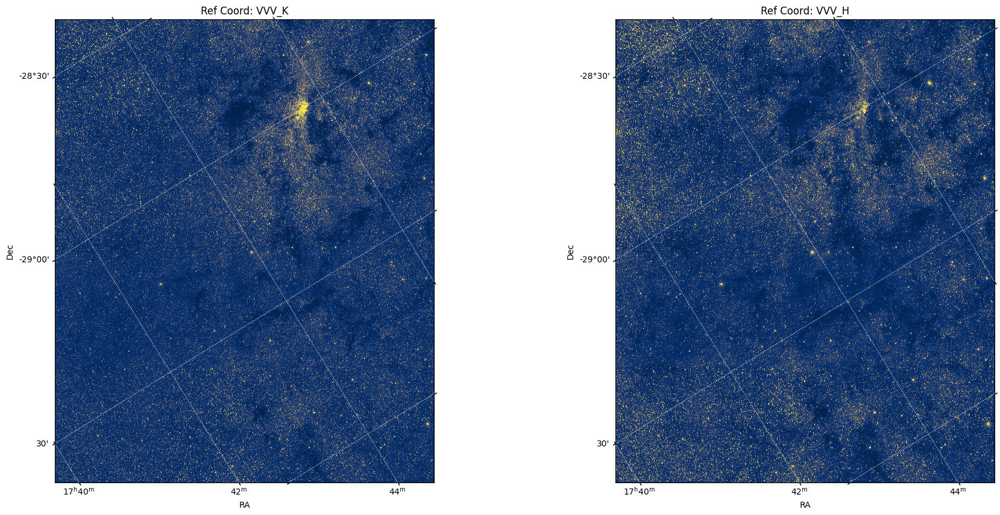

In [ ]:
fits_registration = FitsRegistrationManager()

image_save_dir = os.path.join(root_dir, 'images_added', 'visualize')
if not os.path.exists(image_save_dir):
    os.makedirs(image_save_dir)
for imagefile in imagelist[0:1]:
    image_save_name = '_'.join(os.path.basename(imagefile).split('.fits')[0].split('_')[0:3])+'.png'
    fits_registration.visualize_result(imagefile, ref_header_filename, verbose=True,
                                       image_save=os.path.join(image_save_dir,image_save_name))
    # print(os.path.join(image_save_dir,image_save_name))

Visualizing reprojection result...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


Visualization saved to: 
/home/jiwon/UKIDSSxIRAC/images_added/visualize/gc_vvv_J.png
Visualizing reprojection result...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


Visualization saved to: 
/home/jiwon/UKIDSSxIRAC/images_added/visualize/gc_vvv_K.png


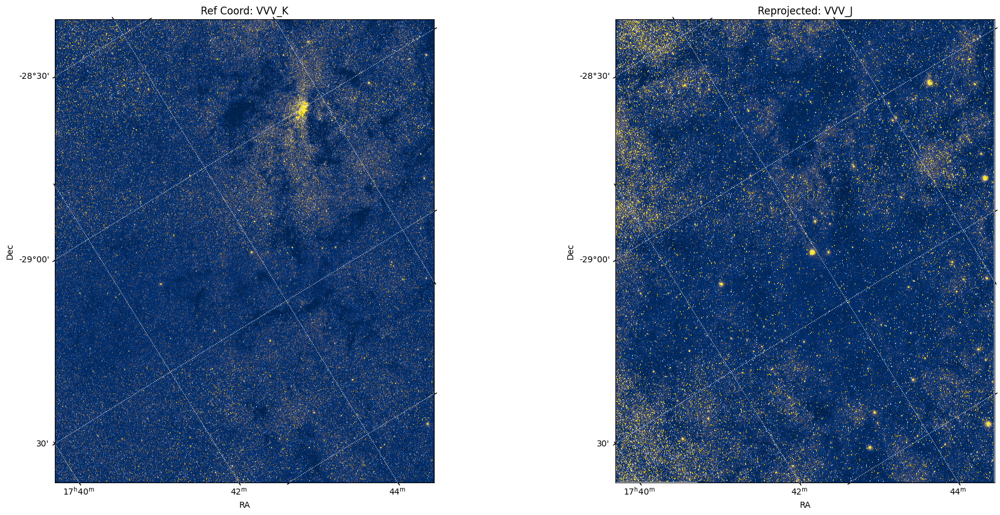

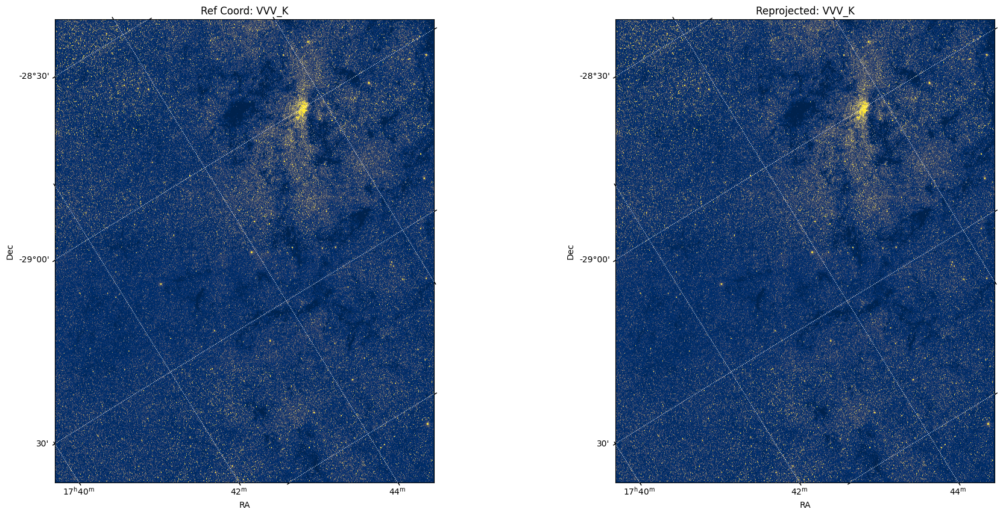

In [ ]:
fits_registration = FitsRegistrationManager()

image_save_dir = os.path.join(root_dir, 'images_added', 'visualize')
if not os.path.exists(image_save_dir):
    os.makedirs(image_save_dir)
for imagefile in imagelist[1:3]:
    image_save_name = '_'.join(os.path.basename(imagefile).split('.fits')[0].split('_')[0:3])+'.png'
    fits_registration.visualize_result(imagefile, ref_header_filename, verbose=True,
                                       image_save=os.path.join(image_save_dir,image_save_name))

Visualizing reprojection result...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


Visualization saved to: 
/home/jiwon/UKIDSSxIRAC/images_added/visualize/gc_irac_ch1.png


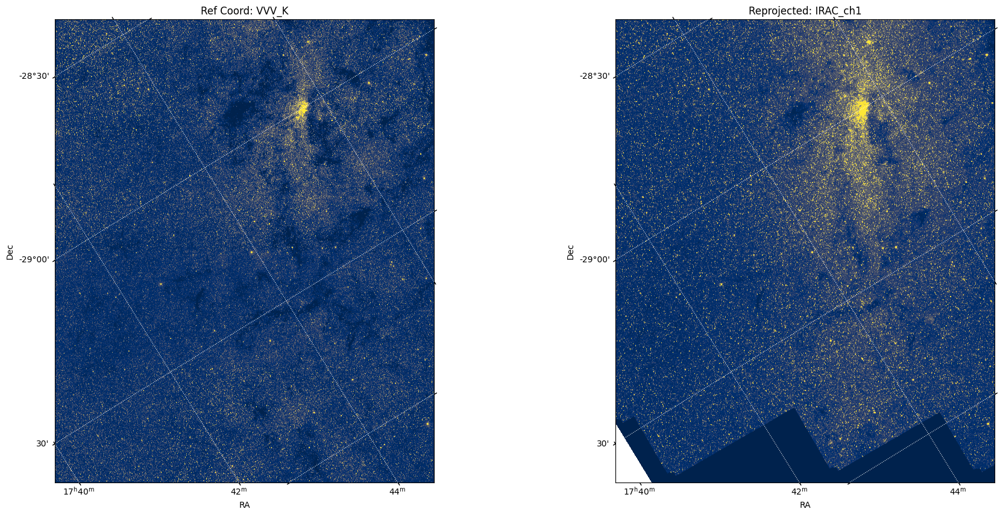

In [ ]:
fits_registration = FitsRegistrationManager()

image_save_dir = os.path.join(root_dir, 'images_added', 'visualize')
if not os.path.exists(image_save_dir):
    os.makedirs(image_save_dir)
for imagefile in imagelist[3:4]:
    image_save_name = '_'.join(os.path.basename(imagefile).split('.fits')[0].split('_')[0:3])+'.png'
    fits_registration.visualize_result(imagefile, ref_header_filename, verbose=True,
                                       image_save=os.path.join(image_save_dir,image_save_name))

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


Text(0.5, 1.0, 'Ref Coord: IRAC_ch1')

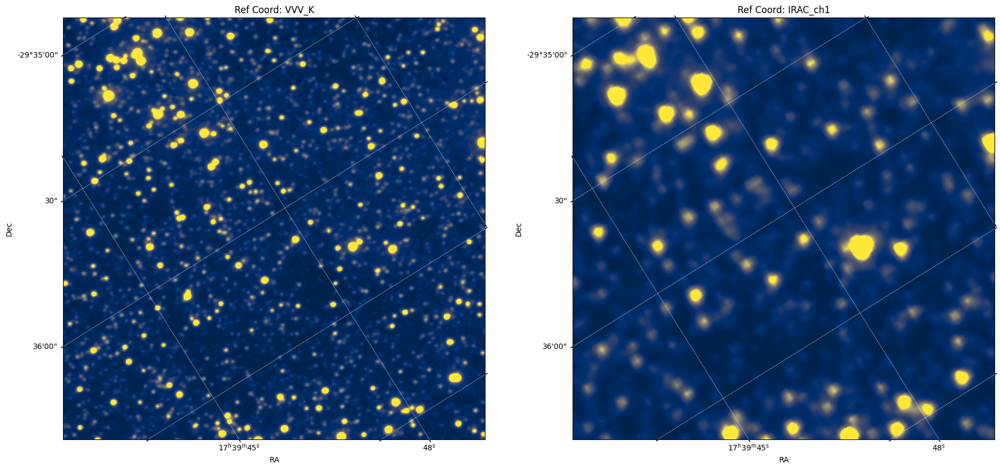

In [ ]:
# fig = plt.figure(figsize = (22, 10))

# ax1 = plt.subplot(121, projection=WCS(ref_header))
# min_val, max_val = get_vmin_vmax(ref_image[7500:7800, 7500:7800], lower_percentile=2, upper_percentile=98)
# ax1.imshow(ref_image[7500:7800, 7500:7800], cmap='cividis', origin='lower', vmax=max_val, vmin=min_val)
# ax1.set_xlabel(r'RA')
# ax1.set_ylabel(r'Dec')
# ax1.grid(color='white', ls='dotted')
# _, title = os.path.basename(ref_header_filename.split('.')[0]).split('gc_')
# title = title.split('_')[0:2]
# ax1.set_title(f'Ref Coord: {title[0].upper()}_{title[1]}')

# ax2 =  plt.subplot(122, projection=WCS(ref_header))
# min_val, max_val = get_vmin_vmax(aligned[7500:7800, 7500:7800], lower_percentile=2, upper_percentile=98)
# ax2.imshow(aligned[7500:7800, 7500:7800], cmap='cividis', origin='lower', vmax=max_val, vmin=min_val)
# ax2.set_xlabel(r'RA')
# ax2.set_ylabel(r'Dec')
# ax2.grid(color='white', ls='dotted')
# _, title = os.path.basename(imagefile.split('.')[0]).split('gc_')
# title = title.split('_')[0:2]
# ax2.set_title(f'Reprojected: {title[0].upper()}_{title[1]}')

Visualizing reprojection result...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


Visualization saved to: 
/home/jiwon/UKIDSSxIRAC/images_added/visualize/gc_irac_ch2.png
Visualizing reprojection result...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


Visualization saved to: 
/home/jiwon/UKIDSSxIRAC/images_added/visualize/gc_irac_ch3.png
Visualizing reprojection result...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


Visualization saved to: 
/home/jiwon/UKIDSSxIRAC/images_added/visualize/gc_irac_ch4.png


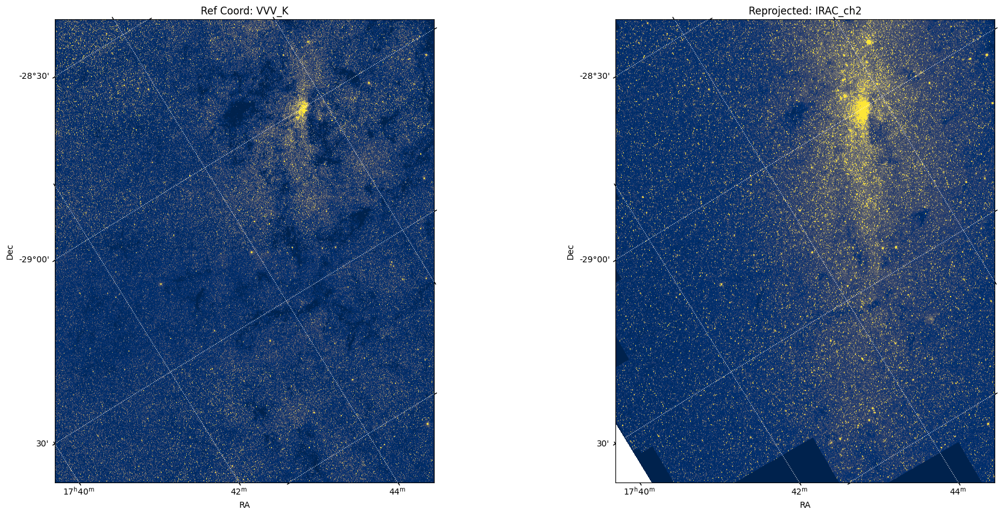

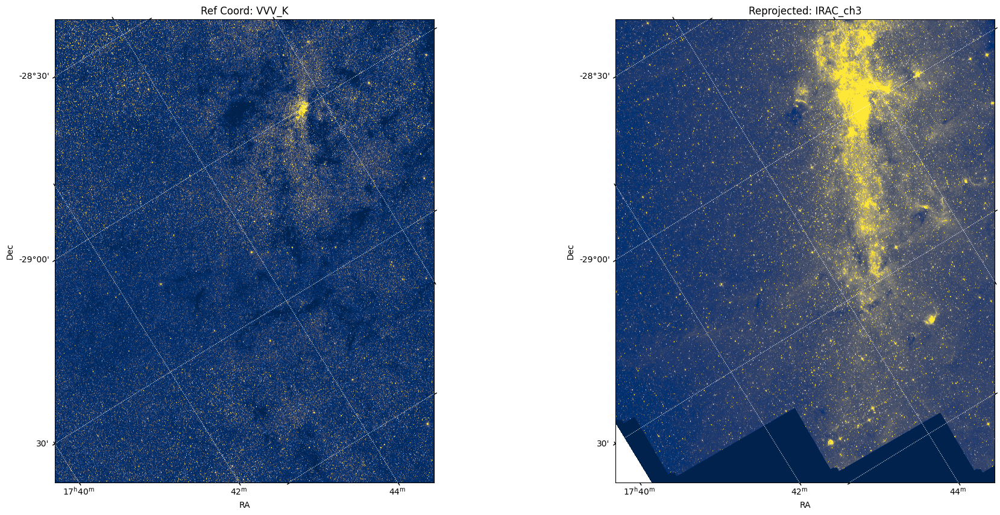

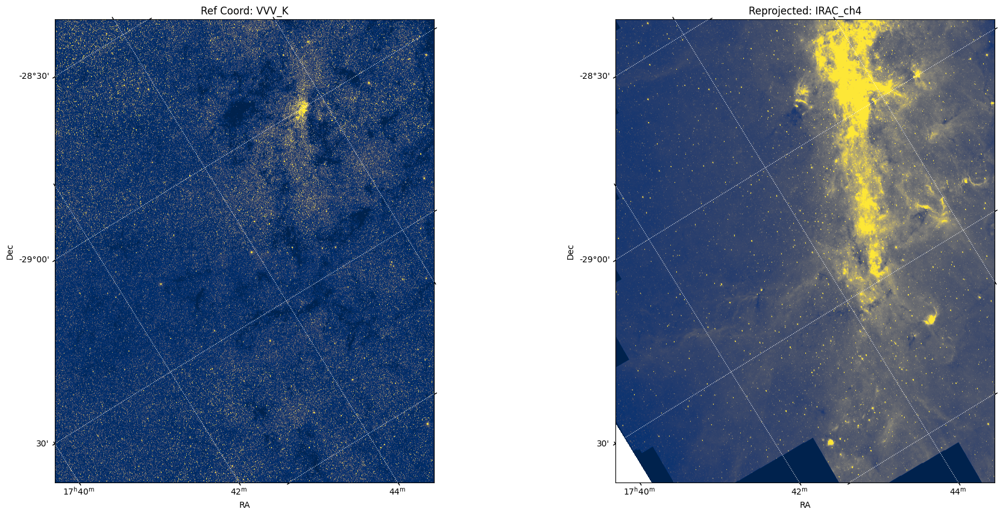

In [ ]:
fits_registration = FitsRegistrationManager()

image_save_dir = os.path.join(root_dir, 'images_added', 'visualize')
if not os.path.exists(image_save_dir):
    os.makedirs(image_save_dir)
for imagefile in imagelist[4:]:
    image_save_name = '_'.join(os.path.basename(imagefile).split('.fits')[0].split('_')[0:3])+'.png'
    fits_registration.visualize_result(imagefile, ref_header_filename, verbose=True,
                                       image_save=os.path.join(image_save_dir,image_save_name))

#### Make a Filelist for Whole Image (Aligned)

In [6]:
# List Up the Files
image_dir1 = os.path.join(root_dir,'images_added',survey1+'_aligned')
image_dir2 = os.path.join(root_dir,'images_added',survey2+'_aligned')

imagelist = []
ref_header_filename = None

imagelist1 = sorted([os.path.abspath(x) for x in glob.glob(os.path.join(image_dir1, f'gc_*.fits'))])
imagelist2 = sorted([os.path.abspath(x) for x in glob.glob(os.path.join(image_dir2, f'gc_*.fits'))])
imagelist= imagelist1+imagelist2
# print('\n'.join(imagelist), '\n')

# Find the Reference Coord File
try:
    from config import ref_coord_band
    ref_header_filename = imagelist[next(i for i, file in enumerate(imagelist) if f'_{ref_coord_band}' in file)]
except StopIteration:
    ref_header_filename = None
    print(f'No reference coordinate file found!')

In [7]:
print('\n'.join(imagelist), '\n')

/home/jiwon/UKIDSSxIRAC/images_added/vvv_aligned/gc_vvv_H.fits
/home/jiwon/UKIDSSxIRAC/images_added/vvv_aligned/gc_vvv_J.fits
/home/jiwon/UKIDSSxIRAC/images_added/vvv_aligned/gc_vvv_K.fits
/home/jiwon/UKIDSSxIRAC/images_added/spitzer_aligned/gc_irac_ch1.fits
/home/jiwon/UKIDSSxIRAC/images_added/spitzer_aligned/gc_irac_ch2.fits
/home/jiwon/UKIDSSxIRAC/images_added/spitzer_aligned/gc_irac_ch3.fits
/home/jiwon/UKIDSSxIRAC/images_added/spitzer_aligned/gc_irac_ch4.fits 



#### Visualization in WCS coord

In [ ]:
fits_registration = FitsRegistrationManager()

# image_save_dir = os.path.join(root_dir, 'images_added', 'visualize')
# for imagefile in imagelist:
#     fits_save_dir = os.path.dirname(imagefile)[0:-4]+'_aligned_cropped'
#     if not os.path.exists(fits_save_dir):
#         os.makedirs(fits_save_dir)
#     fits_save_name = '_'.join(os.path.basename(imagefile).split('.fits')[0].split('_')[0:3])
#     save_name = fits_save_dir + '/' + fits_save_name

ref_image, ref_header = fits_registration.get_image(ref_header_filename, header=True)
reprojected_image, reprojected_header = fits_registration.get_image(imagelist[3], header=True)

fig = plt.figure(figsize = (22, 10))
ax1 = plt.subplot(121, projection=WCS(ref_header))
min_val, max_val = fits_registration.get_vmin_vmax(ref_image, lower_percentile=2, upper_percentile=98)
ax1.imshow(ref_image, cmap='cividis', origin='lower', vmax=max_val, vmin=min_val)
ax1.set_xlabel(r'RA')
ax1.set_ylabel(r'Dec')
ax1.grid(color='white', ls='dotted')
_, title = os.path.basename(ref_header_filename.split('.')[0]).split('gc_')
title = title.split('_')[0:2]
ax1.set_title(f'Ref Coord: {title[0].upper()}_{title[1]}')

ax2 =  plt.subplot(122, projection=WCS(ref_header))
min_val, max_val = fits_registration.get_vmin_vmax(reprojected_image, lower_percentile=2, upper_percentile=98)
ax2.imshow(reprojected_image, cmap='cividis', origin='lower', vmax=max_val, vmin=min_val)
ax2.set_xlabel(r'RA')
ax2.set_ylabel(r'Dec')
ax2.grid(color='white', ls='dotted')
_, title = os.path.basename(imagelist[3].split('.')[0]).split('gc_')
title = title.split('_')[0:2]
ax2.set_title(f'Reprojected: {title[0].upper()}_{title[1]}')

#### Visualization in Galactic Coord (Failed)

In [18]:
from astropy.coordinates import SkyCoord
import astropy.units as u

fits_registration = FitsRegistrationManager()
ref_image, ref_header = fits_registration.get_image(ref_header_filename, header=True)
reprojected_image, reprojected_header = fits_registration.get_image(imagelist[3], header=True)

# 기존 WCS에서 RA/Dec 중심값 가져오기
ref_wcs = WCS(ref_header)
ra_center = ref_wcs.wcs.crval[0]  # CRVAL1 (RA in degrees)
dec_center = ref_wcs.wcs.crval[1]  # CRVAL2 (Dec in degrees)

# RA/Dec -> Galactic 변환
center_coords = SkyCoord(ra=ra_center * u.deg, dec=dec_center * u.deg, frame='fk5')
galactic_coords = center_coords.galactic

# GLON이 360도 근처일 경우 wrap-around
glon = galactic_coords.l.wrap_at(180 * u.deg).degree
glat = galactic_coords.b.degree

ref_galactic = ref_wcs.deepcopy()
ref_galactic.wcs.ctype = ['GLON-CAR', 'GLAT-CAR']
ref_galactic.wcs.crval = [glon, glat]  # Galactic 중심값
ref_galactic.wcs.crpix = ref_wcs.wcs.crpix  # 그대로 유지
ref_galactic.wcs.cd = np.array([[1e-4, 0], [0, 1e-4]])
ref_galactic

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


WCS Keywords

Number of WCS axes: 2
CTYPE : 'GLON-CAR'  'GLAT-CAR'  
CRVAL : -0.5049479914405879  0.14123972377131694  
CRPIX : 6384.017  7825.957  
CD1_1 CD1_2  : 0.0001  0.0  
CD2_1 CD2_2  : 0.0  0.0001  
NAXIS : 12768  15652

In [ ]:
fig = plt.figure(figsize = (22, 10))
ax1 = plt.subplot(121, projection=ref_galactic)
min_val, max_val = fits_registration.get_vmin_vmax(ref_image, lower_percentile=2, upper_percentile=98)
ax1.imshow(ref_image, cmap='cividis', origin='lower', vmax=max_val, vmin=min_val)
ax1.set_xlabel(r'Galactic Longitude')
ax1.set_ylabel(r'Galactic Latitude')
ax1.grid(color='white', ls='dotted')
_, title = os.path.basename(ref_header_filename.split('.')[0]).split('gc_')
title = title.split('_')[0:2]
ax1.set_title(f'Ref Coord: {title[0].upper()}_{title[1]}')

ax2 =  plt.subplot(122, projection=ref_galactic)
min_val, max_val = fits_registration.get_vmin_vmax(reprojected_image, lower_percentile=2, upper_percentile=98)
ax2.imshow(reprojected_image, cmap='cividis', origin='lower', vmax=max_val, vmin=min_val)
ax2.set_xlabel(r'Galactic Longitude')
ax2.set_ylabel(r'Galactic Latitude')
ax2.grid(color='white', ls='dotted')
_, title = os.path.basename(imagelist[3].split('.')[0]).split('gc_')
title = title.split('_')[0:2]
ax2.set_title(f'Reprojected: {title[0].upper()}_{title[1]}')

#### Visualization in Pixel Value

In [ ]:
fits_registration = FitsRegistrationManager()

# image_save_dir = os.path.join(root_dir, 'images_added', 'visualize')
# for imagefile in imagelist:
#     fits_save_dir = os.path.dirname(imagefile)[0:-4]+'_aligned_cropped'
#     if not os.path.exists(fits_save_dir):
#         os.makedirs(fits_save_dir)
#     fits_save_name = '_'.join(os.path.basename(imagefile).split('.fits')[0].split('_')[0:3])
#     save_name = fits_save_dir + '/' + fits_save_name

ref_image, ref_header = fits_registration.get_image(ref_header_filename, header=True)
reprojected_image, reprojected_header = fits_registration.get_image(imagelist[3], header=True)

fig = plt.figure(figsize = (22, 10))
ax1 = plt.subplot(121)#, projection=WCS(ref_header))
min_val, max_val = fits_registration.get_vmin_vmax(ref_image, lower_percentile=2, upper_percentile=98)
ax1.imshow(ref_image, cmap='cividis', origin='lower', vmax=max_val, vmin=min_val)
ax1.set_xlabel(r'RA')
ax1.set_ylabel(r'Dec')
ax1.grid(color='white', ls='dotted')
_, title = os.path.basename(ref_header_filename.split('.')[0]).split('gc_')
title = title.split('_')[0:2]
ax1.set_title(f'Ref Coord: {title[0].upper()}_{title[1]}')

ax2 =  plt.subplot(122)#, projection=WCS(ref_header))
min_val, max_val = fits_registration.get_vmin_vmax(reprojected_image, lower_percentile=2, upper_percentile=98)
ax2.imshow(reprojected_image, cmap='cividis', origin='lower', vmax=max_val, vmin=min_val)
ax2.set_xlabel(r'RA')
ax2.set_ylabel(r'Dec')
ax2.grid(color='white', ls='dotted')
_, title = os.path.basename(imagelist[3].split('.')[0]).split('gc_')
title = title.split('_')[0:2]
ax2.set_title(f'Reprojected: {title[0].upper()}_{title[1]}')

In [ ]:
fits_registration = FitsRegistrationManager()

for imagefile in imagelist[3:]:
    reprojected_image, reprojected_header = fits_registration.get_image(imagefile, header=True)
    min_val, max_val = fits_registration.get_vmin_vmax(reprojected_image, lower_percentile=2, upper_percentile=98)
    plt.imshow(reprojected_image[3000:,:], cmap='cividis', origin='lower', vmax=max_val, vmin=min_val)
    _, title = os.path.basename(imagefile.split('.')[0]).split('gc_')
    title = title.split('_')[0:2]
    plt.title(f'Reprojected: {title[0].upper()}_{title[1]}')
    plt.show()

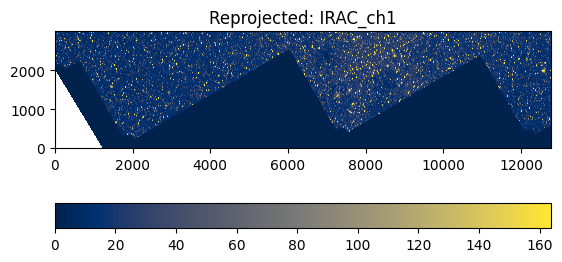

In [24]:
fits_registration = FitsRegistrationManager()

for imagefile in imagelist[3:4]:
    reprojected_image, reprojected_header = fits_registration.get_image(imagefile, header=True)
    min_val, max_val = fits_registration.get_vmin_vmax(reprojected_image, lower_percentile=2, upper_percentile=98)
    plt.imshow(reprojected_image[:3000,:], cmap='cividis', origin='lower', vmax=max_val, vmin=min_val)
    _, title = os.path.basename(imagefile.split('.')[0]).split('gc_')
    title = title.split('_')[0:2]
    plt.title(f'Reprojected: {title[0].upper()}_{title[1]}')
    plt.colorbar(location='bottom')
    plt.show()

#### Save Cropped Version

In [19]:
class FitsRegistrationManager_Cropped:
    def __init__(self, cropping_range):
        self.cropping_range = cropping_range
    
    def select_frame(self, fits_filename, verbose=None):
        if verbose is None:
            from config import verbose_fits_info as default_verbose_fits_info
            verbose = default_verbose_fits_info
        file = fits.open(fits_filename)
        if verbose:
            file.info()
        if len(file) > 2:
            file.info()
            imagenum = input("Insert the frame number on the FITS info and press the [Enter] button.")
            if imagenum > len(file)-1:
                raise ValueError(f"Frame number should be smaller than {len(file)-1}!")
        else:
            imagenum = -1
        return file, imagenum

    def resize_with_projection(self, filename, ref_header_filename, verbose=False):
        '''
        Parameters:
        - reprojected_image: 2D numpy array of the reprojected image.
        - org_data_header: FITS header from the original image being reprojected (IRAC header).
        - ref_header: FITS header from the reference image (VVV header).
        '''
        if verbose:
            print("Conducting reprojection...")
            print(f"  - Registration target: {os.path.basename(filename)}")
            print(f"  - Reference header: {os.path.basename(ref_header_filename)}")
            
        ref_file, ref_num = self.select_frame(ref_header_filename)
        data_file, data_num = self.select_frame(filename)
        ref_header, org_data_header = ref_file[ref_num].header, data_file[data_num].header
        reprojected_image, _ = reproject.reproject_interp(data_file[data_num], ref_header)
        
        cropped_image = reprojected_image[self.cropping_range]
        return cropped_image, org_data_header, ref_header
    
    def update_header(self, reprojected_image, org_data_header, ref_header, 
                      additional_keys=None, verbose=False):
        if verbose:
            print("Updating header...")

        # Update information based on a copy of original header
        new_header = copy.deepcopy(org_data_header)

        # Update WCS keys from ref_header
        update_keys = [
                'CTYPE1', 'CTYPE2', 'CRVAL1', 'CRVAL2',  # WCS-related keys
                'CRPIX1', 'CRPIX2', 'CD1_1', 'CD1_2', 'CD2_1', 'CD2_2'  # Projection matrix
            ]
        for key in update_keys:
            if key in ref_header:
                new_header[key] = ref_header[key]
            else:
                print(f"  - Key {key} not found in ref_header. Skipping.")
        
        # Update the image dimensions
        new_header['NAXIS'] = 2
        new_header['NAXIS1'] = reprojected_image.shape[1]  # Width of the image
        new_header['NAXIS2'] = reprojected_image.shape[0]  # Height of the image

        # Update CRPIX for cropping offset
        crop_y, crop_x = self.cropping_range
        new_header['CRPIX1'] -= crop_x.start if crop_x.start else 0  # Adjust CRPIX1
        new_header['CRPIX2'] -= crop_y.start if crop_y.start else 0  # Adjust CRPIX2

        # Update EQUINOX and RADESYS if necessary
        if 'EQUINOX' in ref_header:
            new_header['EQUINOX'] = ref_header['EQUINOX']  # Ensure the coordinate system is consistent
        else:
            print("  - EQUINOX key missing in ref_header.")
        if 'RADESYS' in ref_header:
            new_header['RADESYS'] = ref_header['RADESYS']  # Match the reference coordinate system
        else:
            print("  - RADESYS key missing in ref_header.")

        # Dynamically add specific keys from the original header if they exist
        if additional_keys is None:
            additional_keys = ['EXPTIME', 'DATE-OBS', 'DATE_OBS']
        for key in additional_keys:
            if key in org_data_header:
                new_header[key] = org_data_header[key]
                        
        # Preserve specific keys from the original header that are critical
        preserve_keys = ['TELESCOP', 'INSTRUME', 'BUNIT']  # Instrument-related metadata
        for key in preserve_keys:
            if key in org_data_header:
                new_header[key] = org_data_header[key]
            else:
                if verbose:
                    print(f"  - Key {key} not found in org_data_header.")
        if 'FILTER' in org_data_header:
            new_header['FILTER'] = org_data_header['FILTER']
        elif 'CHNLNUM' in org_data_header:
            new_header['FILTER'] = 'CH'+str(org_data_header['CHNLNUM'])
        else:
            if verbose:
                print("  - FILTER and CHNLNUM keys missing in org_data_header.")
        
        # Add comments and history
        new_header['COMMENT'] = "Reprojected to match the VVV coordinate system."
        new_header['HISTORY'] = "Reprojection performed using astropy.reproject."
        return new_header
    
    def save_as_npy(self, reprojected_image, save_name):#, filename, ref_header_filename):
        np.save(save_name, reprojected_image)

    def save_as_fits(self, reprojected_image, new_header, save_name):
        hdu = fits.PrimaryHDU(data=reprojected_image, header=new_header)
        hdu_list = fits.HDUList([hdu])
        hdu_list.writeto(save_name, overwrite=True)

    def get_image(self, filename, header=False):
        file = fits.open(filename)
        image = file[-1].data
        if header:
            header = file[-1].header
            return image, header
        else:
            return image
        
    def get_vmin_vmax(self, image, lower_percentile=1, upper_percentile=99):
        vmin = np.nanpercentile(image, lower_percentile)
        vmax = np.nanpercentile(image, upper_percentile)
        return vmin, vmax
 
    def visualize_result(self, filename, ref_header_filename, image_save=None, verbose=False):
        if verbose: print("Visualizing reprojection result...")
        ref_image, ref_header = self.get_image(ref_header_filename, header=True)
        reprojected_image = self.resize_with_projection(filename, ref_header_filename)[0]
        fig = plt.figure(figsize = (22, 10))

        ax1 = plt.subplot(121, projection=WCS(ref_header))
        min_val, max_val = self.get_vmin_vmax(ref_image, lower_percentile=2, upper_percentile=98)
        ax1.imshow(ref_image, cmap='cividis', origin='lower', vmax=max_val, vmin=min_val)
        ax1.set_xlabel(r'RA')
        ax1.set_ylabel(r'Dec')
        ax1.grid(color='white', ls='dotted')
        _, title = os.path.basename(ref_header_filename.split('.')[0]).split('gc_')
        title = title.split('_')[0:2]
        ax1.set_title(f'Ref Coord: {title[0].upper()}_{title[1]}')

        ax2 =  plt.subplot(122, projection=WCS(ref_header))
        min_val, max_val = self.get_vmin_vmax(reprojected_image, lower_percentile=2, upper_percentile=98)
        ax2.imshow(reprojected_image, cmap='cividis', origin='lower', vmax=max_val, vmin=min_val)
        ax2.set_xlabel(r'RA')
        ax2.set_ylabel(r'Dec')
        ax2.grid(color='white', ls='dotted')
        _, title = os.path.basename(filename.split('.')[0]).split('gc_')
        title = title.split('_')[0:2]
        ax2.set_title(f'Reprojected: {title[0].upper()}_{title[1]}')

        if image_save:
            plt.savefig(image_save, dpi=300, bbox_inches='tight')
            if verbose: print(f"Visualization saved to: \n{image_save}")
        else:
            plt.show()

    def conduct_registration(self, filename, ref_header_filename, save_name, save_as_fits=True, save_as_npy=False, verbose=False):
        '''
        Conducts the full registration process: load, reproject, update header, and save.
    
        Parameters:
        - filename: str, path to the image file to be reprojected.
        - ref_header_filename: str, path to the reference header file.
        - save_name: str, output file name for saving the reprojected image.
        - save_as_fits: bool, whether to save the result as a FITS file (default: True).
        - save_as_npy: bool, whether to save the result as a NumPy file (default: False).
        - verbose: bool, whether to print detailed logs.
        '''
        import time
        start = time.time()

        # Step 1: Reproject the image
        reprojected_image, org_data_header, ref_header = self.resize_with_projection(filename, ref_header_filename, verbose=verbose)
        if verbose:
            print(f"  - Save as FITS: {save_as_fits}, Save as NumPy: {save_as_npy}")
            print(f'Reprojected Image Size: {reprojected_image.shape}')
            print("\n#-- 1. Reprojection completed.\n")

        # Step 2: Update the header
        new_header = self.update_header(reprojected_image, org_data_header, ref_header, verbose=verbose)
        if verbose:
            print("\n#-- 2. Header updated.\n")

        # Step 3: Save the reprojected image
        if save_as_fits:
            fits_save_name = f"{save_name}.fits"
            self.save_as_fits(reprojected_image, new_header, fits_save_name)
            if verbose:
                print(f"\n#-- 3. FITS file saved: {fits_save_name}\n")
        if save_as_npy:
            npy_save_name = f"{save_name}.npy"
            self.save_as_npy(reprojected_image, npy_save_name)
            if verbose:
                print(f"\n#-- 3. NumPy file saved: {npy_save_name}\n")

        if verbose:
            end = time.time()
            print(f"### Registration process completed. [{int(end-start)} sec]")
            print('\n')

In [26]:
fits_registration = FitsRegistrationManager_Cropped(cropping_range = np.s_[3000:, :])

for imagefile in imagelist:
    fits_save_dir = os.path.dirname(imagefile)+'_cropped'
    if not os.path.exists(fits_save_dir):
        os.makedirs(fits_save_dir)
    fits_save_name = '_'.join(os.path.basename(imagefile).split('.fits')[0].split('_')[0:3])
    save_name = fits_save_dir + '/' + fits_save_name

    fits_registration.conduct_registration(imagefile, ref_header_filename, save_name, save_as_fits=True, verbose=True)
    # if imagefile == '/home/jiwon/UKIDSSxIRAC/images_added/vvv_raw/gc_vvv_H.fits.fz':
    #     fits_registration.visualize_result(imagefile, ref_header_filename, verbose=True)

Conducting reprojection...
  - Registration target: gc_vvv_H.fits
  - Reference header: gc_vvv_K.fits
  - Save as FITS: True, Save as NumPy: False
Reprojected Image Size: (12652, 12768)

#-- 1. Reprojection completed.

Updating header...
  - RADESYS key missing in ref_header.

#-- 2. Header updated.


#-- 3. FITS file saved: /home/jiwon/UKIDSSxIRAC/images_added/vvv_aligned_cropped/gc_vvv_H.fits

### Registration process completed. [724 sec]


Conducting reprojection...
  - Registration target: gc_vvv_J.fits
  - Reference header: gc_vvv_K.fits
  - Save as FITS: True, Save as NumPy: False
Reprojected Image Size: (12652, 12768)

#-- 1. Reprojection completed.

Updating header...
  - RADESYS key missing in ref_header.

#-- 2. Header updated.


#-- 3. FITS file saved: /home/jiwon/UKIDSSxIRAC/images_added/vvv_aligned_cropped/gc_vvv_J.fits

### Registration process completed. [783 sec]


Conducting reprojection...
  - Registration target: gc_vvv_K.fits
  - Reference header: gc_vvv_K.fits
  - 

In [25]:
fits_registration = FitsRegistrationManager_Cropped(cropping_range = np.s_[3000:, :6000])

for imagefile in imagelist:
    fits_save_dir = os.path.dirname(imagefile)+'_sparse_cropped'
    if not os.path.exists(fits_save_dir):
        os.makedirs(fits_save_dir)
    fits_save_name = '_'.join(os.path.basename(imagefile).split('.fits')[0].split('_')[0:3])
    save_name = fits_save_dir + '/' + fits_save_name

    fits_registration.conduct_registration(imagefile, ref_header_filename, save_name, save_as_fits=True, verbose=True)
    # if imagefile == '/home/jiwon/UKIDSSxIRAC/images_added/vvv_raw/gc_vvv_H.fits.fz':
    #     fits_registration.visualize_result(imagefile, ref_header_filename, verbose=True)

Conducting reprojection...
  - Registration target: gc_vvv_H.fits
  - Reference header: gc_vvv_K.fits


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


  - Save as FITS: True, Save as NumPy: False
Reprojected Image Size: (12652, 6000)

#-- 1. Reprojection completed.

Updating header...
  - RADESYS key missing in ref_header.

#-- 2. Header updated.


#-- 3. FITS file saved: /home/jiwon/UKIDSSxIRAC/images_added/vvv_aligned_sparse_cropped/gc_vvv_H.fits

### Registration process completed. [765 sec]


Conducting reprojection...
  - Registration target: gc_vvv_J.fits
  - Reference header: gc_vvv_K.fits


  - Save as FITS: True, Save as NumPy: False
Reprojected Image Size: (12652, 6000)

#-- 1. Reprojection completed.

Updating header...
  - RADESYS key missing in ref_header.

#-- 2. Header updated.


#-- 3. FITS file saved: /home/jiwon/UKIDSSxIRAC/images_added/vvv_aligned_sparse_cropped/gc_vvv_J.fits

### Registration process completed. [735 sec]


Conducting reprojection...
  - Registration target: gc_vvv_K.fits
  - Reference header: gc_vvv_K.fits
  - Save as FITS: True, Save as NumPy: False
Reprojected Image Size: (12652, 6000)

#-- 1. Reprojection completed.

Updating header...
  - RADESYS key missing in ref_header.

#-- 2. Header updated.


#-- 3. FITS file saved: /home/jiwon/UKIDSSxIRAC/images_added/vvv_aligned_sparse_cropped/gc_vvv_K.fits

### Registration process completed. [722 sec]


Conducting reprojection...
  - Registration target: gc_irac_ch1.fits
  - Reference header: gc_vvv_K.fits
  - Save as FITS: True, Save as NumPy: False
Reprojected Image Size: (12652, 6000)

#-- 1. 